In [1]:
import pandas as pd
import xarray as xr
import metpy
import metpy.calc as mpcalc
from metpy.plots import SkewT
from metpy.units import units
from datetime import datetime
import os
import matplotlib.pyplot as plt

In [2]:
list_files = os.listdir('/data/slasher/a/hmm2/RELAMPAGOSoundings/')

In [57]:
file_type = []
CSU_sounds = []
CSU_times = []
for file in list_files:
    file_ending = file[12:]
    if file_ending in file_type:
        None
    else:
        file_type.append(file_ending)
    if 'CSU' in file_ending:
        CSU_sounds.append(file)
        CSU_times.append(file[0:12])
    else:
        continue

In [4]:
time_list = []
for time in CSU_times:
    time_list.append(datetime.strptime(time,'%Y%m%d%H%M'))

In [70]:
def extract_data(file_name):
    time = datetime.strptime(file_name[0:12], '%Y%m%d%H%M')
    
    # Skip certain rows within the dataset (the first 27 rows contain metadata)
    skip_rows = list(range(28))

    # Also make sure to skip the row that contains units
    skip_rows.append(29)
    
    # Read in the data
    df = pd.read_table('/data/slasher/a/hmm2/RELAMPAGOSoundings/'+file_name, delim_whitespace=True, skiprows=skip_rows, usecols=list(range(0, 12)))
    
    # Ensure columns have the proper names
    df = df.rename(columns = {'Elapsed':'time',
                              'time':'HeightMSL',
                              'HeightMSL':'P',
                              'P':'Temp',
                              'Temp':'Dewp',
                              'Dewp':'RH',
                              'RH':'Wind_Speed',
                              'Speed':'Wind_Dir',
                              'Dir':'AscRate',
                              'AscRate':'Lat',
                              'Lat':'Lon',
                              'Lon':'GpsHeightMSL'})
    return df, time

In [42]:
datetime(2018, 11, 10, 20, 31).strftime('%Y%m%d%H%M')

'201811102031'

In [71]:
df, time = extract_data(CSU_sounds[0])

In [72]:
time

datetime.datetime(2018, 10, 31, 15, 13)

In [73]:
df['Potential_T'] = mpcalc.potential_temperature(df['P'].values * units.hPa, df['Temp'].values * units.degC)

In [90]:
def extract_data(file_name):
    time = datetime.strptime(file_name[0:12], '%Y%m%d%H%M')
    
    # Skip certain rows within the dataset (the first 27 rows contain metadata)
    skip_rows = list(range(28))

    # Also make sure to skip the row that contains units
    skip_rows.append(29)
    
    # Read in the data
    df = pd.read_table('/data/slasher/a/hmm2/RELAMPAGOSoundings/'+file_name, delim_whitespace=True, skiprows=skip_rows, usecols=list(range(0, 12)))
    
    # Ensure columns have the proper names
    df = df.rename(columns = {'Elapsed':'time',
                              'time':'HeightMSL',
                              'HeightMSL':'P',
                              'P':'Temp',
                              'Temp':'Dewp',
                              'Dewp':'RH',
                              'RH':'Wind_Speed',
                              'Speed':'Wind_Dir',
                              'Dir':'AscRate',
                              'AscRate':'Lat',
                              'Lat':'Lon',
                              'Lon':'GpsHeightMSL'})
    
    # Add a field for potential temperature, which has units in Kelvin
    df['Potential_T'] = mpcalc.potential_temperature(df['P'].values * units.hPa, df['Temp'].values * units.degC)
    
    return df, time

def skew_plot(df, time, sounding_loc='CSU', barb_density=75):
    """
    Plots a Skew-T Thermodynamic Diagram using the dataframe provided. This can be used for further analysis.
    
    Input:
    df = Pandas dataframe containting neccessary data (ex. Pressure, Temperature, Dewpoint, Wind Speed, Wind Direction)
    
    Output:
    Saved figure
    """
    
    # Setup the data
    
    # Extract values for pressure and assign units hectopascals
    p = df['P'].values * units.hPa
    
    # Extract values for temperarture and assign units degrees Celsius
    T = df['Temp'].values * units.degC
    
    # Extract values for dewpoint and assign units degrees Celsius
    Td = df['Dewp'].values * units.degC
    
    # Extract values for wind speed and assign units knots
    wind_speed = df['Wind_Speed'].values * units.knots
    
    # Extract values for wind direction and assign units degrees
    wind_direction = df['Wind_Dir'].values * units.degrees
    
    # Convert u/v wind components of the wind using wind speed and direction
    u, v = mpcalc.wind_components(wind_speed, wind_direction)
    
    # Setup the figure, using a large figure size
    fig = plt.figure(figsize=(15, 15))
    
    # Utilize the Skew-T functionality within MetPy to create the diagram and rotate axes 45 degrees
    skew = SkewT(fig, rotation=45)
    
    # Plot data

    # Plot the temperature in red
    skew.plot(p, T, 'r')
    
    # Plot the dewpoint in green
    skew.plot(p, Td, 'g')
    
    # Plot the wind barbs using the barb_density value (default = every 75)
    skew.plot_barbs(p[::barb_density], u[::barb_density], v[::barb_density])
    
    # Set the vertical limits (1000 hPa to 100 hPa)
    skew.ax.set_ylim(1000, 100)
    
    # Set the temperature axis limits
    skew.ax.set_xlim(-30, 60)
    
    # Add more lines for reference
    skew.plot_dry_adiabats()
    skew.plot_moist_adiabats()
    skew.plot_mixing_lines()
    
    plt.title(sounding_loc + time.strftime(' Sounding %H%MZ %d %b %Y '))
    
    return plt.savefig('Soundings/' + sounding_loc + '/sounding_' + sounding_loc + time.strftime('_%Y%m%d_%H%MZ.png'))

def theta_plot(df, time, x_axis_var = 'Potential_T', sounding_loc='CSU'):
    # Setup the figure
    fig = plt.figure(figsize=(10, 8))
    ax = plt.axes()
    
    # Plot the Potential Temperature Values
    ax.plot(df['Potential_T'].values, df['P'].values)
    
    # Make sure the vertical pressure axis is descending as it goes up
    ax.set_ylim(1000, 200)
    
    # Add a label to the axis for Potential Temperature
    ax.set_xlabel('Potential Temperature (Kelvin)')
    
    # Add a label to the axis for Pressure
    ax.set_ylabel('Pressure (hPa)')
    
    # Add a title including the sounding location and the time of the sounding
    plt.title(sounding_loc + time.strftime(' Sounding %H%M UTC %d %b %Y '))
    
    # Save the figure
    return plt.savefig('Theta_Profiles/' + sounding_loc + '/ThetaProfile_' +sounding_loc + time.strftime('_%Y%m%d_%H%MZ.png'))

In [91]:
b/RELAMPAGO_Analysis/Theta_Profiles/CSU

NameError: name 'b' is not defined

/data/keeling/a/mgrover4/a/miniconda3/envs/xesmf_env/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/data/keeling/a/mgrover4/a/miniconda3/envs/xesmf_env/lib/python3.7/site-packages/ipykernel_launcher.py:97: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


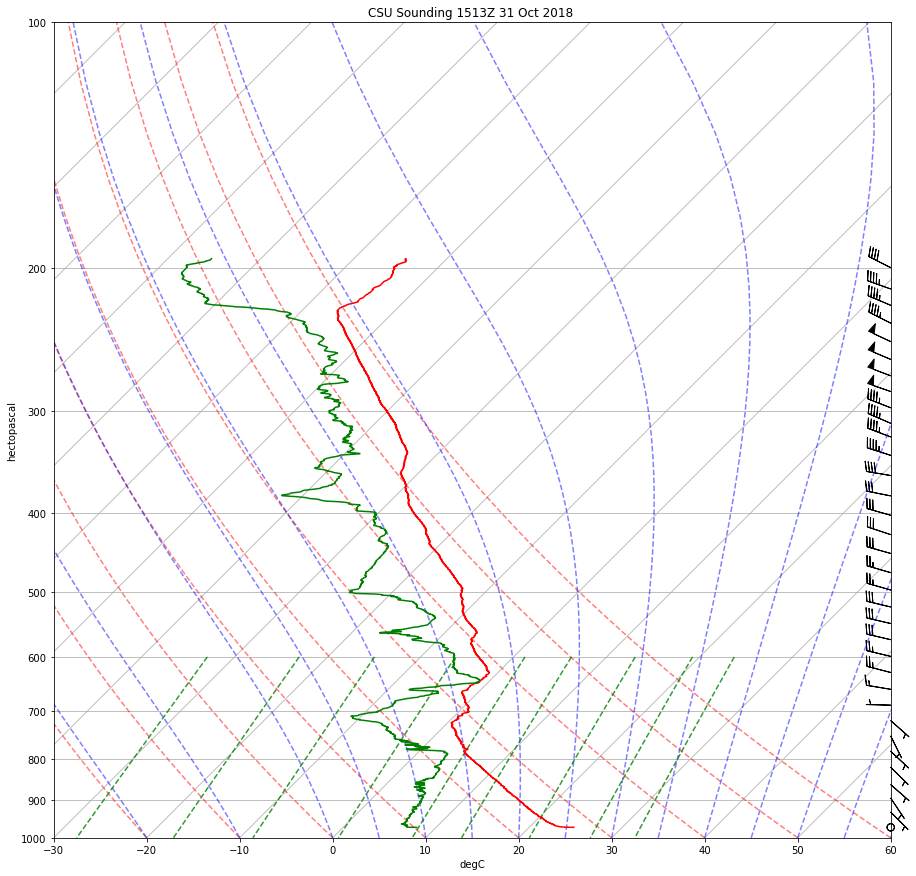

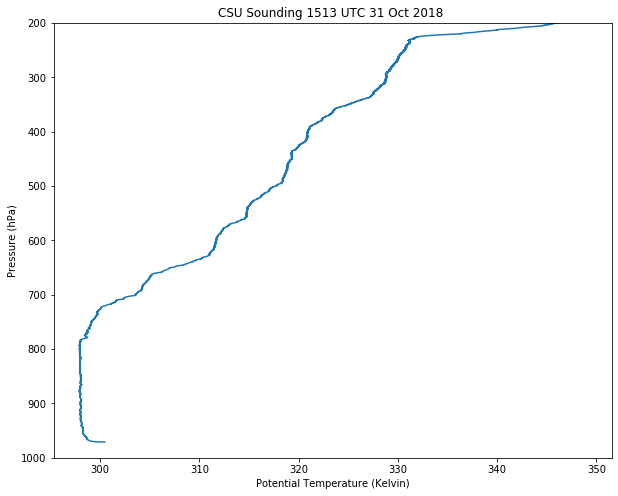

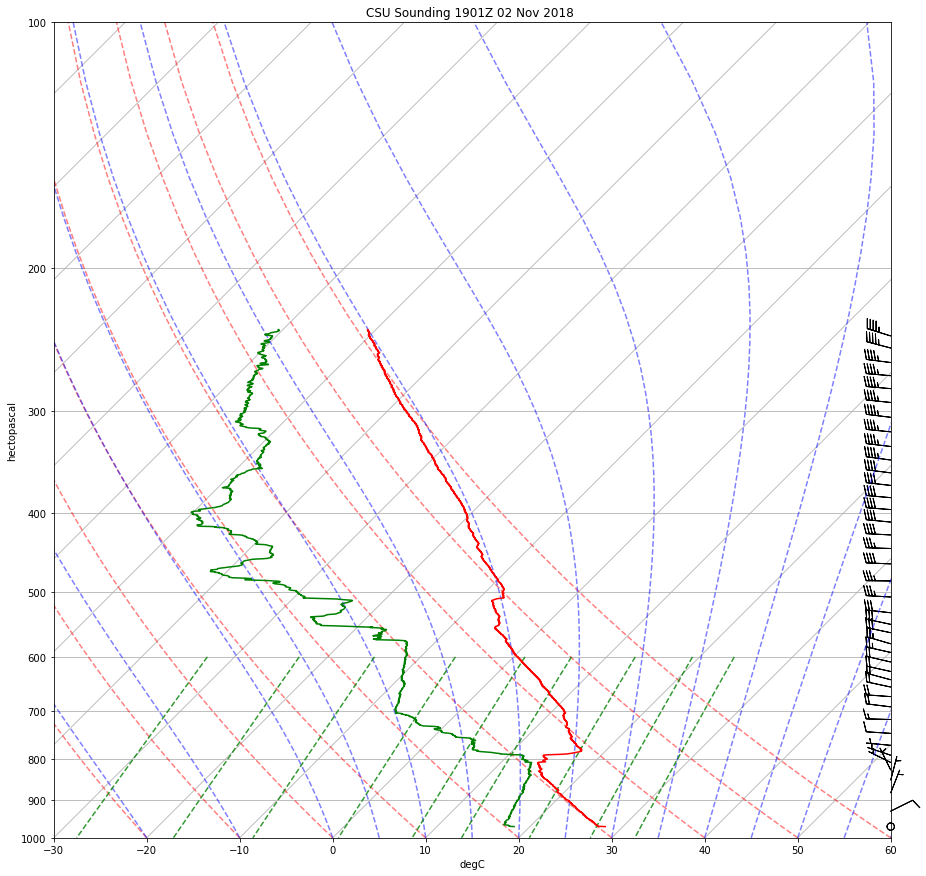

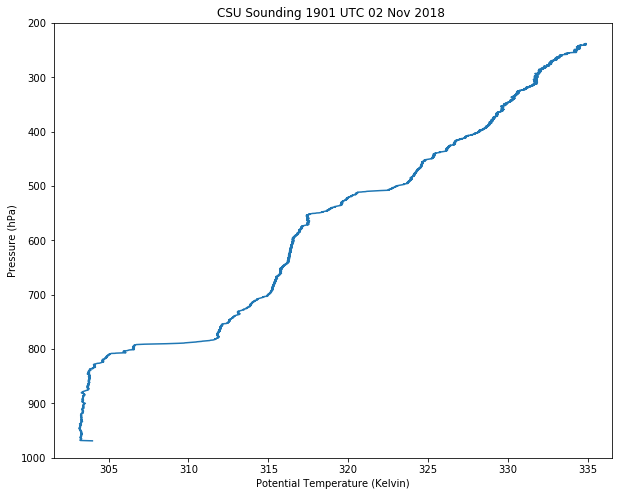

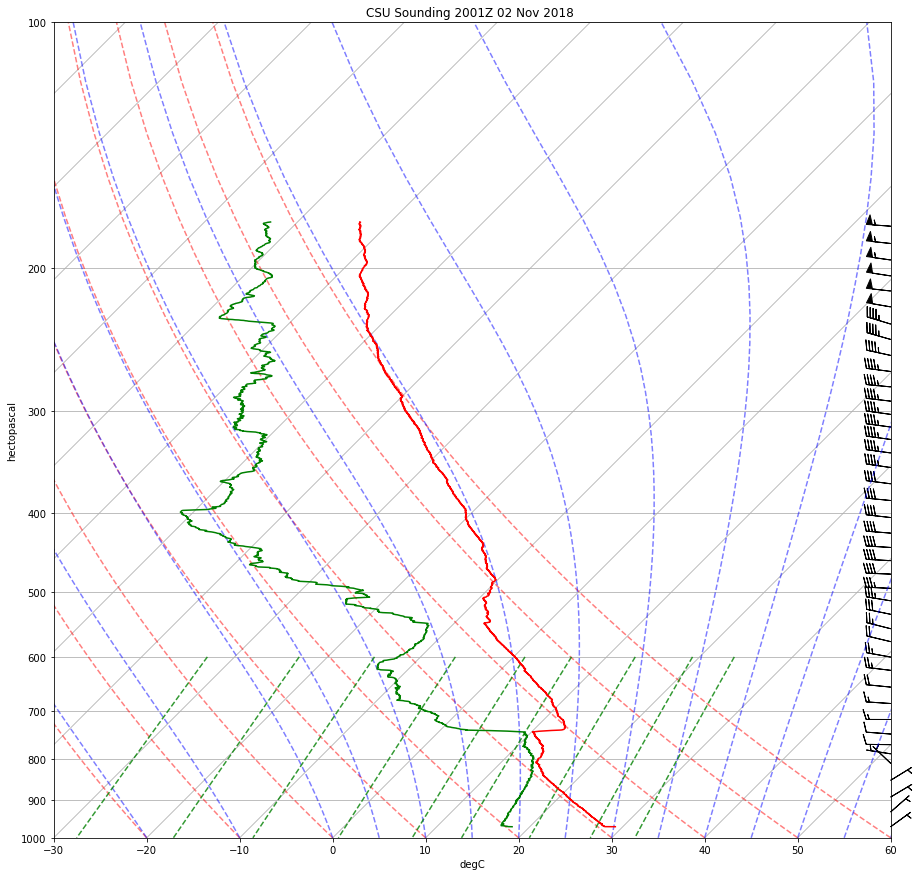

...

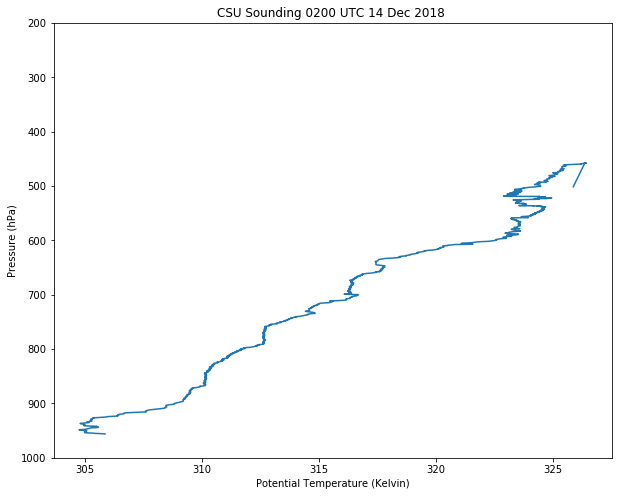

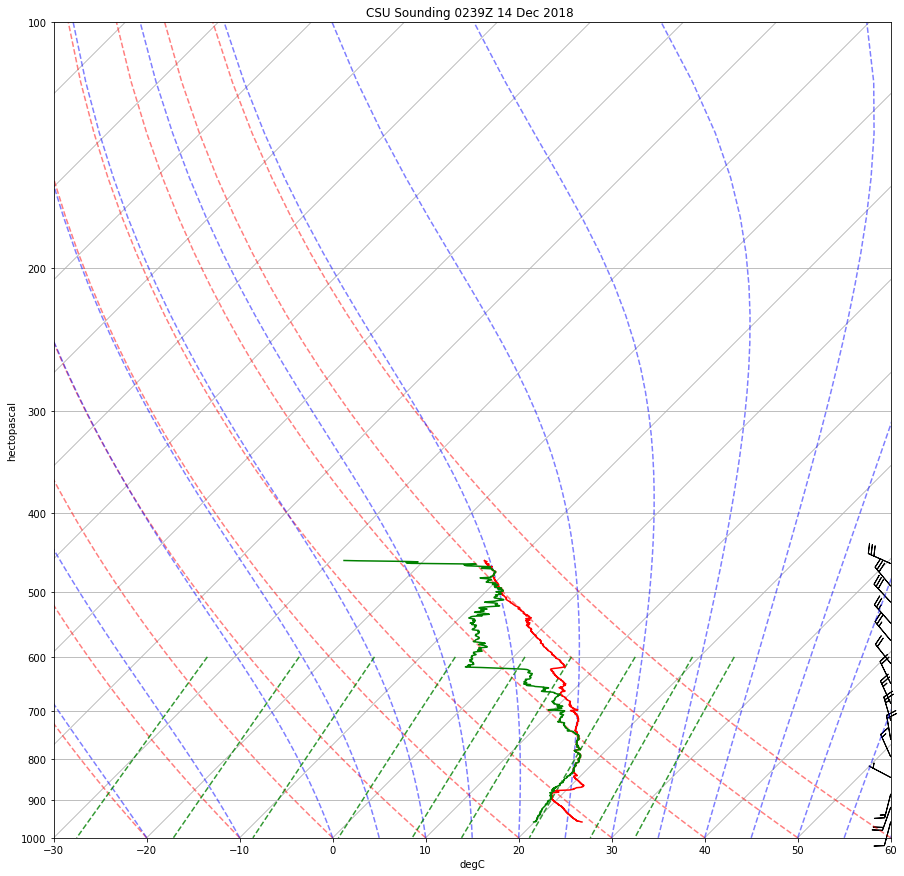

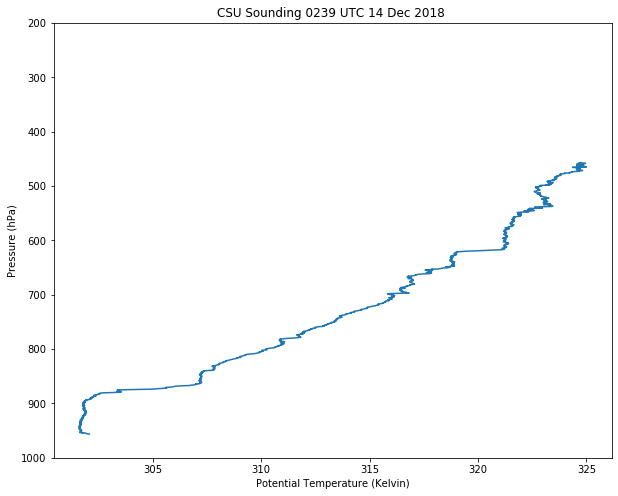

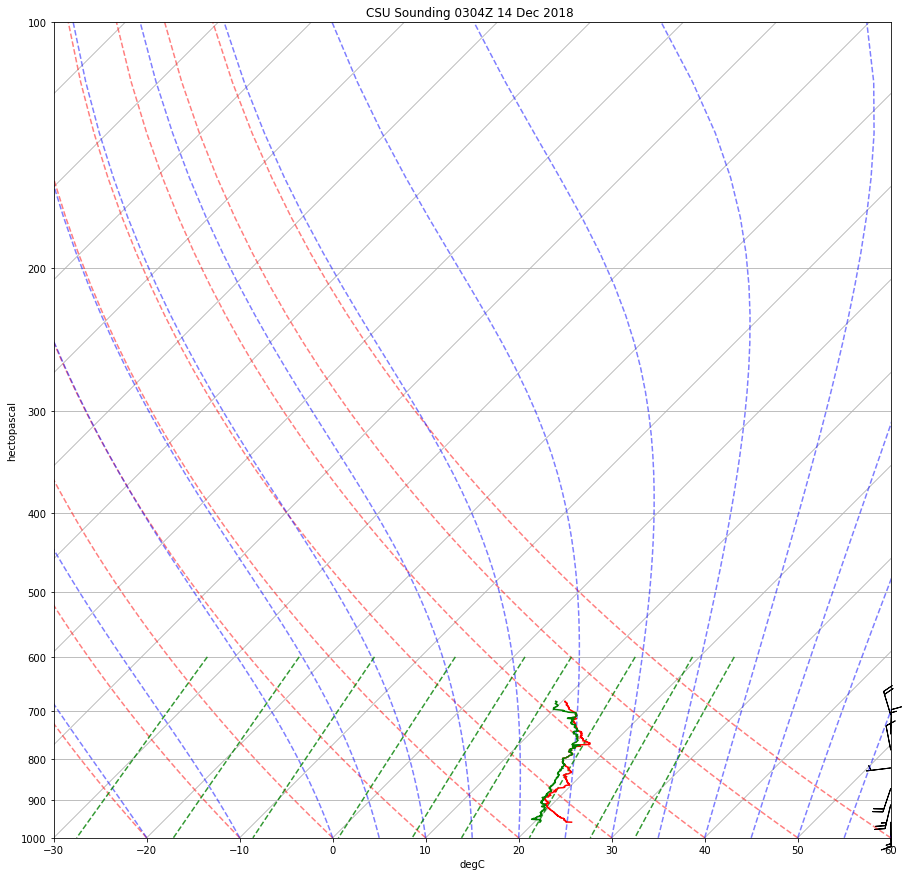

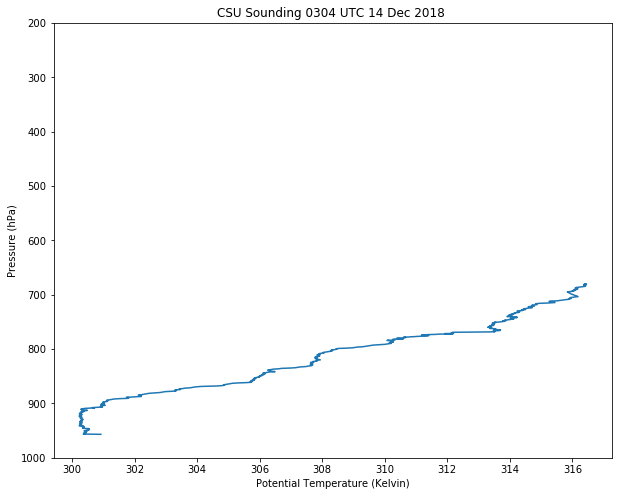

In [92]:
for file in CSU_sounds:
    df, time = extract_data(file)
    skew_plot(df, time)
    theta_plot(df, time)

In [ ]:
skew_plot(df, time)

In [ ]:
time_string = CSU_sounds[0][0:12]

In [ ]:
datetime.strptime(time_string, '%Y%m%d%H%M')

In [ ]:
file_type

In [ ]:
def select_data(loc, time):
    

In [ ]:
month = 10
day = 31
hour = 15
minute = 13

time = datetime(2018, month, day, hour, minute)

In [ ]:
time_string = time.strftime('%Y%m%d%H%M')
print(time_string)

In [ ]:
time.strftime('%H%MZ %d %b %Y ')

In [ ]:
# Skip certain rows within the dataset (the first 27 rows contain metadata)
skip_rows = list(range(28))

# Also make sure to skip the row that contains units
skip_rows.append(29)

In [ ]:
# Read in the dataset using Pandas
df = pd.read_table('/data/slasher/a/hmm2/RELAMPAGOSoundings/'+time_string+'-CSU-rts.txt', delim_whitespace=True, skiprows=skip_rows, usecols=list(range(0, 12)))

# Ensure columns have the proper names
df = df.rename(columns = {'Elapsed':'time',
                     'time':'HeightMSL',
                     'HeightMSL':'P',
                     'P':'Temp',
                     'Temp':'Dewp',
                     'Dewp':'RH',
                     'RH':'Wind_Speed',
                     'Speed':'Wind_Dir',
                     'Dir':'AscRate',
                     'AscRate':'Lat',
                     'Lat':'Lon',
                     'Lon':'GpsHeightMSL'})